In [2]:
!pip install albumentations

Defaulting to user installation because normal site-packages is not writeable
     |████████████████████████████████| 102 kB 8.1 MB/s eta 0:00:01
     |████████████████████████████████| 14.0 MB 60.4 MB/s eta 0:00:01B 60.4 MB/s eta 0:00:01████▉           | 9.1 MB 60.4 MB/s eta 0:00:01
     |████████████████████████████████| 47.8 MB 93.6 MB/s eta 0:00:01     |████                            | 5.9 MB 93.6 MB/s eta 0:00:010:01      | 17.2 MB 93.6 MB/s eta 0:00:01████████████▏               | 24.2 MB 93.6 MB/s eta 0:00:01██▏           | 30.1 MB 93.6 MB/s eta 0:00:01�█████████████████████▍       | 36.3 MB 93.6 MB/s eta 0:00:01��███████████████████▉   | 43.0 MB 93.6 MB/s eta 0:00:01
     |████████████████████████████████| 3.3 MB 106.3 MB/s eta 0:00:01
     |████████████████████████████████| 179 kB 56.3 MB/s eta 0:00:01
     |████████████████████████████████| 6.9 MB 42.7 MB/s eta 0:00:01███████▍            | 4.2 MB 42.7 MB/s eta 0:00:01
     |████████████████████████████████| 2.0 MB 43.6 MB/s 

In [8]:
import albumentations as A
from albumentations.pytorch import ToTensorV2
import numpy as np
import rasterio as rio
import matplotlib.pyplot as plt
#import torch
from rasterio.plot import show
#import torchvision
%matplotlib inline

In [347]:
a_transform = A.Compose(
    [
        # Meh
        #A.SmallestMaxSize(max_size=160),
        #A.ShiftScaleRotate(shift_limit=0.05, scale_limit=0.05, rotate_limit=15, p=0.5),
        #A.RandomCrop(height=128, width=128),
        #A.RGBShift(r_shift_limit=15, g_shift_limit=15, b_shift_limit=15, p=0.5),
        #A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        #A.ColorJitter(p=1),
        #A.CenterCrop(224, 224, p=1),
        
        # Goodish
        
        A.OneOf([
            A.Emboss(),
            A.GaussianBlur()
        ]),
        A.OpticalDistortion(),
        
         # Sharpens image?
        
        A.Flip(),
        
        # Rotates / flips / crops
        A.OneOf([
            A.Transpose(p=5/6),
            A.geometric.rotate.RandomRotate90(p=5/6),
            #A.ShiftScaleRotate(p=5/6),
            A.RandomResizedCrop(224, 224, p=5/6)
        ]),
        
        
        # Needs tuning
        #A.RandomBrightnessContrast(p=0.5),
        
        #A.OneOf([
            #A.OpticalDistortion(p=0.3),
            #A.GridDistortion(p=.1),
            #A.IAAPiecewiseAffine(p=0.3),
        #],
        
        
        ToTensorV2(),
    ]
)
#train_dataset = CatsVsDogsDataset(images_filepaths=train_images_filepaths, transform=train_transform)

In [2]:
img_path = "/cephyr/NOBACKUP/groups/globalpoverty1/Kakooei/DatasetAfricaPoverty/TenYears/Geo0/0000012768-0000011872.tif"
img_src = rio.open(img_path)
img_numpy = img_src.read()
img_tensor = torch.from_numpy(img_numpy)

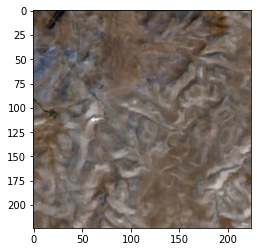

<AxesSubplot:>

In [3]:
show(img_src.read([3,2,1]), adjust=True)

In [ ]:
print(type(img_tensor), img_tensor.shape)
tensor_image = img_tensor.permute([1,2,0])
print(type(tensor_image), tensor_image.shape)

rgb_tensor = tensor_image[:, :, 0:3]
print(type(rgb_tensor), rgb_tensor.shape)
#rgb_tensor[] = rgb_tensor.permute([2,0,1])

plt.imshow(rgb_tensor)
plt.show()

In [ ]:
aug = [
    transforms.Resize(224*2),
    transforms.CenterCrop(224*2),
    transforms.RandomResizedCrop(224),
    transforms.RandomApply([
        transforms.ColorJitter(0.4, 0.4, 0.4, 0.1)  # not strengthened
    ], p=0.8),
    #transforms.RandomGrayscale(p=0.2),
    transforms.RandomApply(
        [moco.loader.GaussianBlur([.1, 2.])], p=0.5),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    normalize
]

In [150]:
## TEST IMAGES ##
#################
#################
#################

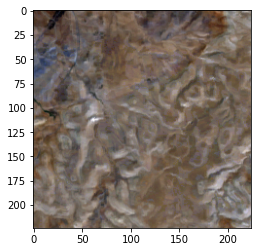

<AxesSubplot:>

In [199]:
img_numpy = img_src.read()
show(img_numpy[(10,9,8),:,:], adjust=True)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(80, 224, 224)
(224, 224, 80)
<class 'torch.Tensor'>
torch.Size([80, 224, 224])


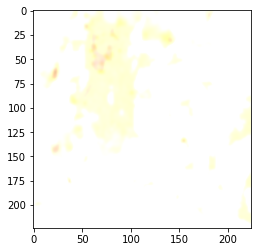

array([[[ 0.363194  ,  0.6779056 ,  1.0344752 , ...,  0.3444444 ,
          0.28170103, -0.28356746],
        [ 0.43009204,  0.6976178 ,  1.0123734 , ...,  0.33532557,
          0.25994387, -0.28356746],
        [ 0.59662545,  0.8503875 ,  0.98405564, ...,  0.33672845,
          0.3357202 , -0.28356746],
        ...,
        [ 1.5303513 ,  1.9936963 ,  2.163045  , ...,  0.34467822,
          1.724927  , -0.29983008],
        [ 1.5303513 ,  1.9936963 ,  2.163045  , ...,  0.34467822,
          1.724927  , -0.29983008],
        [ 1.5047307 ,  1.9779266 ,  2.0925956 , ...,  0.34374294,
          1.6331246 , -0.29983008]],

       [[ 0.46140602,  0.75084084,  1.1063058 , ...,  0.3444444 ,
          0.3118306 , -0.28356746],
        [ 0.47421628,  0.7202869 ,  1.0475981 , ...,  0.34514585,
          0.26343235, -0.28356746],
        [ 0.5325741 ,  0.85137314,  1.0261871 , ...,  0.34514585,
          0.3333246 , -0.28356746],
        ...,
        [ 1.5246578 ,  2.0173512 ,  2.1105533 , ...,  

In [62]:
img_numpy = img_src.read()
print(np.shape(img_numpy))
img_numpy = img_numpy.transpose(1,2,0)
print(np.shape(img_numpy))
aug_tensor = aug_a(image=img_numpy)["image"]
print(type(aug_tensor))
print(aug_tensor.size())

show(aug_tensor.detach().numpy()[(10,9,8),:,:], adjust=False)

img_numpy

In [322]:
plt.imshow(aaug_tensor.detach().numpy()[0:3,:,:])

NameError: name 'aaug_tensor' is not defined

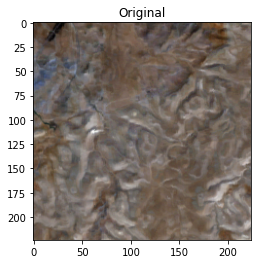

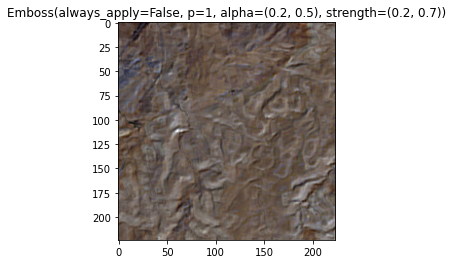

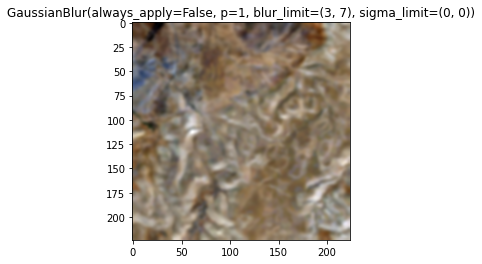

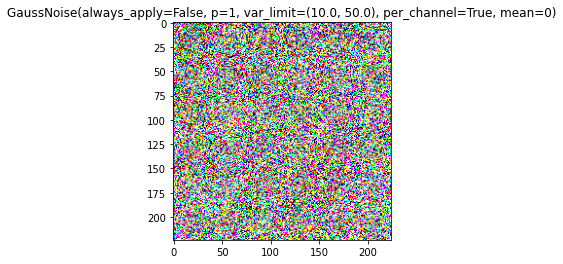

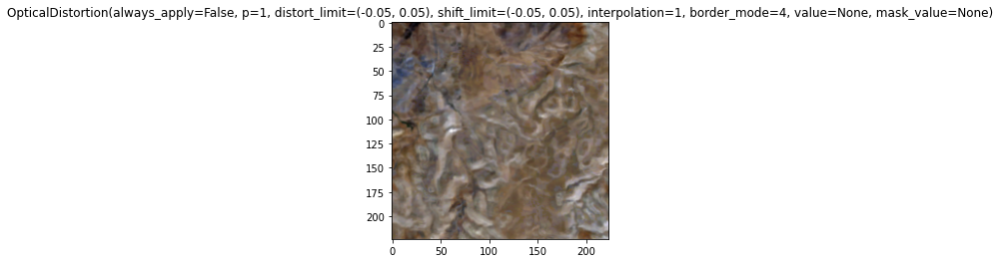

...

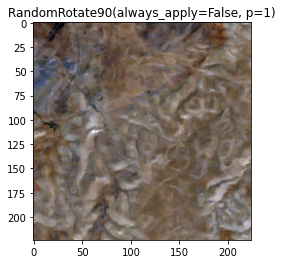

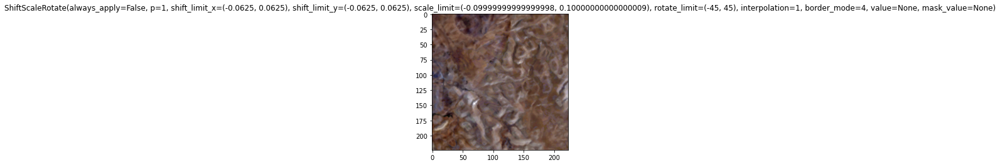

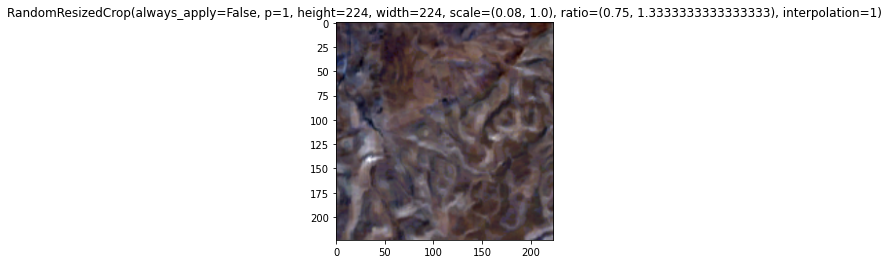

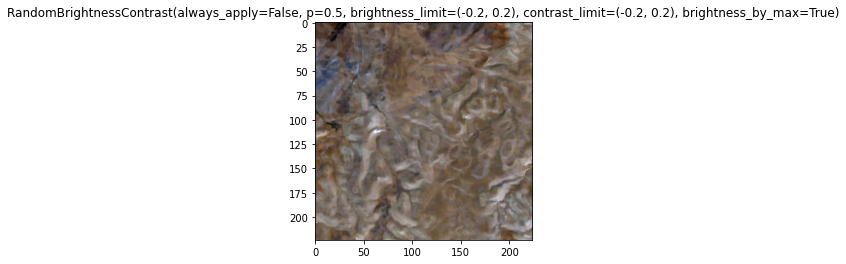

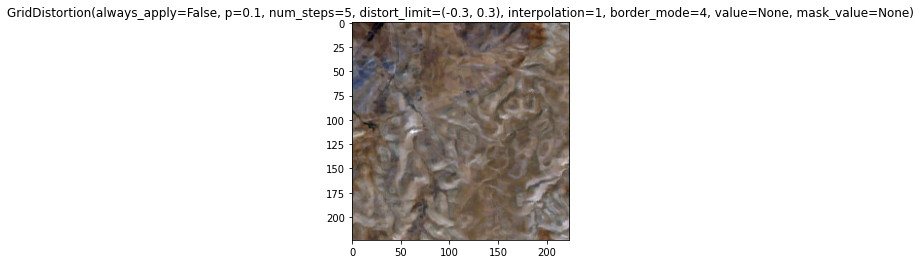

In [4]:
# AUGMENTATIONS
augmentations = [
    A.Emboss(p=1), 
    A.GaussianBlur(p=1), 
    A.GaussNoise(p=1),
    A.OpticalDistortion(p=1), 
    A.Flip(p=1),
    A.Transpose(p=1),
    A.geometric.rotate.RandomRotate90(p=1),
    A.ShiftScaleRotate(p=1),
    A.RandomResizedCrop(224, 224, p=1),
    A.RandomBrightnessContrast(p=0.5),
    A.GridDistortion(p=.1),
    #A.IAAPiecewiseAffine(p=0.3)
]

plt.title("Original")
show(img_src.read([3,2,1]), adjust=True)

for aug in augmentations:
    transform = A.Compose([
        aug,
        ToTensorV2()
    ])

    img_numpy = img_src.read()
    img_numpy = img_numpy.transpose(1,2,0)
    aug_tensor = transform(image=img_numpy)["image"]
    
    plt.title(aug)
    show(aug_tensor.detach().numpy()[(10,9,8),:,:], adjust=True)

# Test augs for MoCo

In [11]:
aug_a = A.Compose([
    #A.Resize(224, 224, )
    
    A.RandomResizedCrop(224, 224, scale=(0.08, 1.0), ratio=(0.75, 1.3333333333333333)),
    A.GaussianBlur(p=0.5),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    ToTensorV2()
])

aug = A.Compose([
            ToTensorV2()
        ])

In [3]:
import sys
sys.path.insert(0, '/cephyr/NOBACKUP/groups/globalpoverty1/JesperBenjamin/geography-aware-ssl/moco_fmow/moco')
from ms_nl_resnet import MS_NL_ResNet18

import importlib

import fmow_dataloader
importlib.reload(fmow_dataloader)

train_csv = "/cephyr/NOBACKUP/groups/globalpoverty1/JesperBenjamin/imagepathfull.csv"

In [15]:
train_dataset = fmow_dataloader.CustomDatasetFromImagesTemporal(train_csv,
    transform=aug_a)
train_loader = torch.utils.data.DataLoader(
        train_dataset, batch_size=5)

In [141]:

for i, (images, labels) in enumerate(train_loader):
    print(type(images))
    #print(images)
    
    break

<class 'list'>


In [142]:
images[0].size()

torch.Size([5, 8, 224, 224])

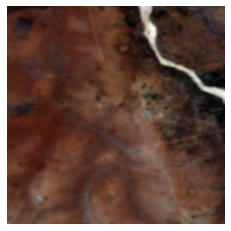

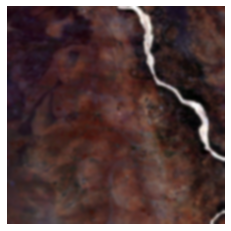

<AxesSubplot:>

In [143]:
plt.axis('off')
show(images[0][2].detach().numpy()[(2,1,0),:,:], adjust=True)
plt.axis('off')
show(images[1][2].detach().numpy()[(2,1,0),:,:], adjust=True)


In [42]:
!nvidia-smi

Thu Apr 28 15:27:20 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.39.01    Driver Version: 510.39.01    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  On   | 00000000:31:00.0 Off |                    0 |
| N/A   28C    P0    78W / 400W |   7546MiB / 40960MiB |    100%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
|   1  NVIDIA A100-SXM...  On   | 00000000:4B:00.0 Off |                    0 |
| N/A   

# Plot images for report

In [1]:
import pandas as pd


In [2]:
train_csv = "/cephyr/NOBACKUP/groups/globalpoverty1/JesperBenjamin/imagepathfull.csv"
image_paths = pd.read_csv(train_csv)

In [33]:
import pandas as pd

train_csv = "/cephyr/NOBACKUP/groups/globalpoverty1/JesperBenjamin/imagepathfull.csv"
image_paths = pd.read_csv(train_csv)

sample_imgs = image_paths.sample(frac=0.0003)
sample_imgs.size

41

In [4]:
band_stats = {
  "means": {
   "BLUE": 0.06614169065743208,
   "GREEN": 0.09635988259340068,
   "RED": 0.11381173286380034,
    }, 
    "stds": {
       "BLUE": 0.03512808462999218,
       "GREEN": 0.050729950158437294,
       "RED": 0.07239252056994558,
    }
}

band_stats

{'means': {'BLUE': 0.06614169065743208,
  'GREEN': 0.09635988259340068,
  'RED': 0.11381173286380034},
 'stds': {'BLUE': 0.03512808462999218,
  'GREEN': 0.050729950158437294,
  'RED': 0.07239252056994558}}

In [5]:
def index_to_year(index):
    start_year = 1990 + index*3
    end_year = start_year + 2
    return str(start_year) + "-" + str(end_year)

In [9]:
# Set plot size
plt.rcParams["figure.figsize"] = (20,10)

<ipython-input-34-d357bfe68623>:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, (ax1, ax2, ax3) = plt.subplots(1, 3)


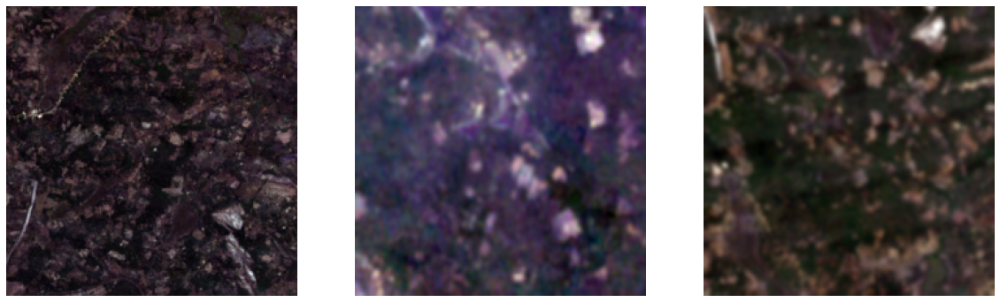

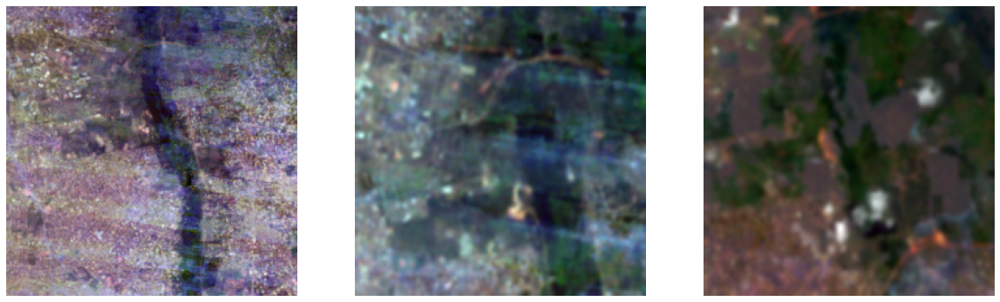

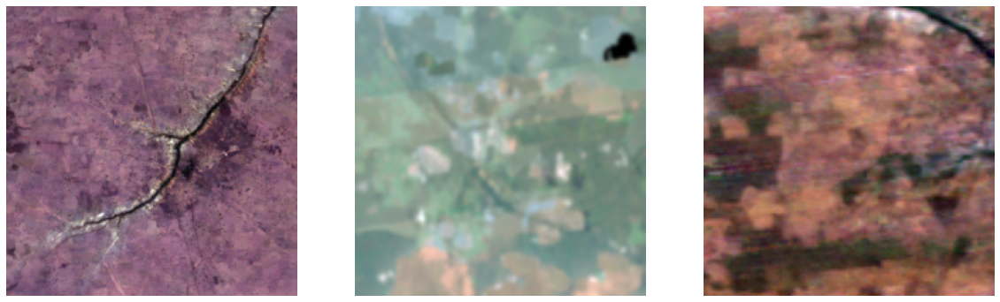

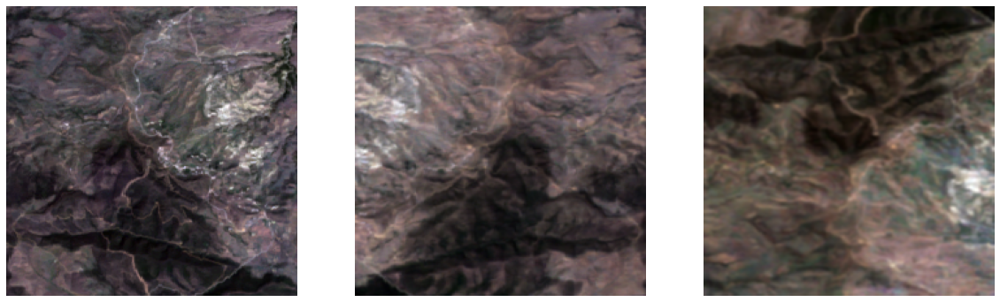

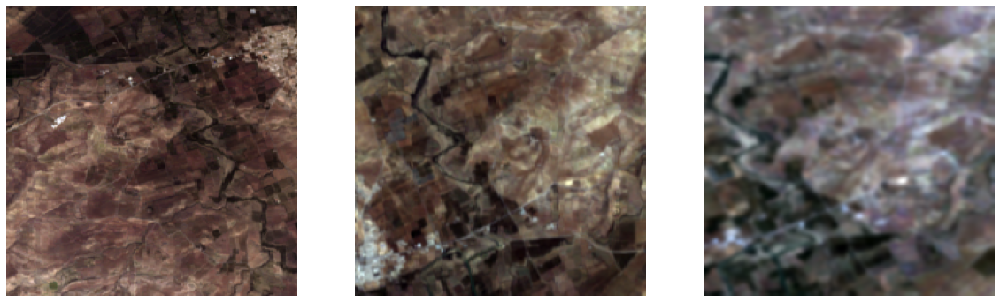

...

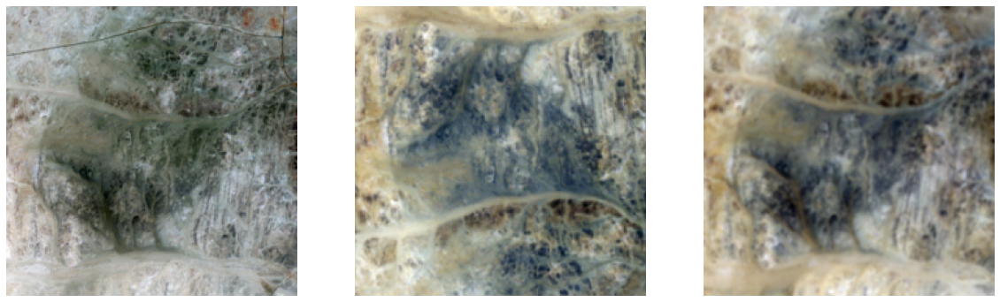

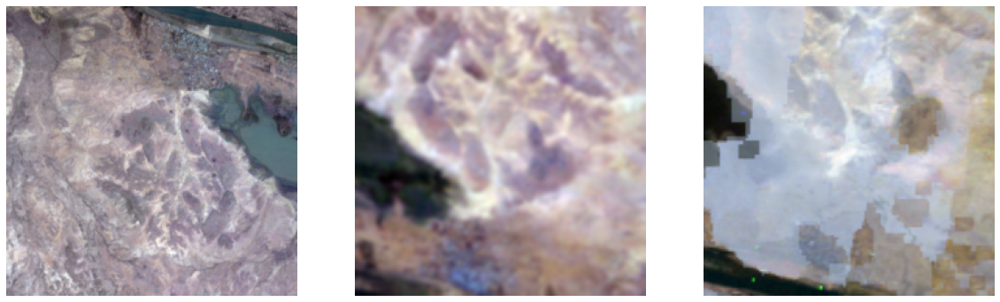

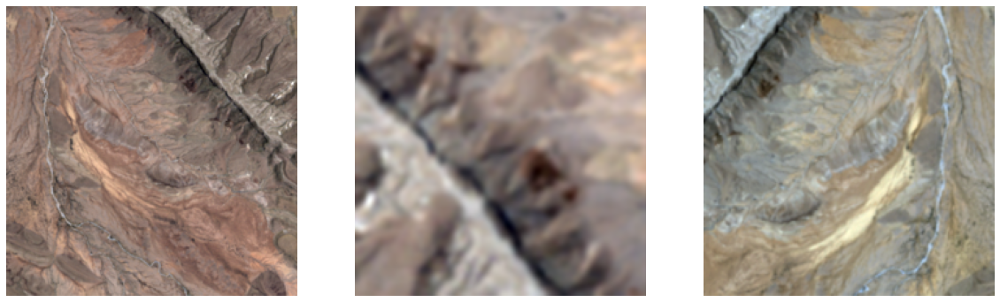

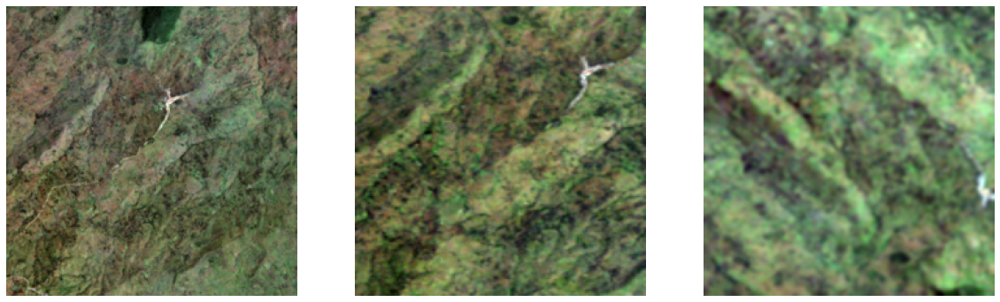

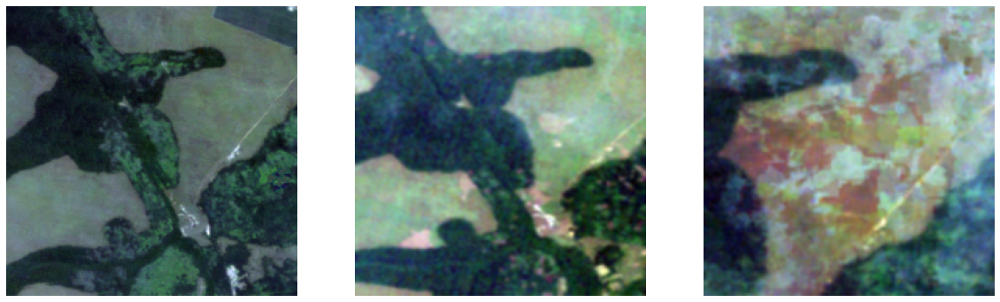

In [ ]:
composite_n = 9

i_row = 0
for index, row in sample_imgs.iterrows():
    img_path = row.iloc[0]
    
    
    #print(img_path)
    
    img_src = rio.open(img_path)
    img_numpy = img_src.read()
    #img_tensor = torch.from_numpy(img_numpy)

    ## Select two different temporal composites
    # Select two timestamps
    t1, t2 = np.random.choice(a=8, size=2, replace=False)
    
    # REMOVES TEMPORALITY
    #t1=9
    #t2=9
    
    # Extract 8 corresponding bands for image 1 and 2
    img_t1 = img_numpy[8*t1 : 8*t1+8]
    img_t2 = img_numpy[8*t2 : 8*t2+8]

    # Transpose data from (CHW) format of PyTorch to fit (HWC) format of ALbumentations
    img_t1 = np.transpose(img_t1, (1,2,0))
    img_t2 = np.transpose(img_t2, (1,2,0))


    # Apply transformation to images separatelyy
    img_t1 = aug_a(image=img_t1)['image']
    img_t2 = aug_a(image=img_t2)['image']
    
    # NO AUGMENTATIONS
    #img_t1 = aug(image=img_t1)['image']
    #img_t2 = aug(image=img_t2)['image']
    
    img_org = img_src.read([8*composite_n + 1, 8*composite_n + 2, 8*composite_n + 3])
    
    img_list = [img_org, img_t1.detach().numpy(), img_t2.detach().numpy()]
    composite_indices = [composite_n, t1, t2]
    
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
    axs = [ax1, ax2, ax3]
    #fig.suptitle('Horizontally stacked subplots')
    
    for i_img, img in enumerate(img_list):
        if i_img == 0:
            first_img = img
            
        band_max = [0] * 3
        band_min = [0] * 3
        
        
        for i_band, band in enumerate(["BLUE", "GREEN", "RED"]):
            # "Unnormalize" images
            img[i_band] = (img[i_band] * band_stats["stds"][band]) + band_stats["means"][band]# + 0.15
            
            #if i_img == 0:
            #    for x in range(3):
            #        band_max[x] = np.max(img[x])
            #        print(band_max[x])
            #        band_min[x] = np.min(img[x])
            #        print(band_min[x])
            # Normalize to between 0-1
            #band_max = np.max(first_img[i_band])
            #band_min = np.min(first_img[i_band])
            #img[i_band] = (img[i_band] - band_min[i_band]) / (band_max[i_band] - band_min[i_band])

        axs[i_img].axis('off')
        #if i_img == 0:
        #    axs[i_img].set_title('Original', fontsize=20)
        #else:
        #    axs[i_img].set_title('Augmented', fontsize=20)
        #axs[i_img].set_title(index_to_year(composite_indices[i_img]), fontsize=20)
        show(img[(2,1,0),:,:], ax=axs[i_img], adjust=True)
        fig.show()
    
    #plt.axis('off')
    #show(img_src.read([8*composite_n + 3, 8*composite_n + 2, 8*composite_n + 1]), adjust=True)
    #plt.axis('off')
    #show(img_t1.detach().numpy()[(2,1,0),:,:], adjust=True)
    #plt.axis('off')
    #show(img_t2.detach().numpy()[(2,1,0),:,:], adjust=True)
    
    #print('________________________________________')
    i_row +=1
    #if i_row >= 50:
    #    break


